Manran Zhu 20607509  

Implement High-dynamic range imaging based on Debevec-Malik method in section 10.2 in Szeliski's book.  
I separated the whole implementation into six parts:  
    1. sample intensities  
    2. estimation of the camera response function(Using Debevec and Malik's Algorithm), we need to find the camera response curve for R/G/B channal separately  
    3. calculate radiance map  
    4. use step1-3 to build corresponding HDR  
    5. adjust result image by tone mapping(gamma correction)  
    6. adjust result image by average intensity

In [1]:
%matplotlib notebook

import numpy as np
import numpy.linalg as la
import matplotlib.image as image
import matplotlib.pyplot as plt

mini = 0
maxi = 255
def load_imgs(filename):
    my_imgs = np.array([ image.imread(filename+"1.jpeg"),image.imread(filename+"2.jpeg"),image.imread(filename+"3.jpeg")])
    return my_imgs

In [2]:
# helper function, return a image with intensities in (0, 255)
def img_normalize(img):
    difference = img - img.min()
    parameter = 255.0/difference.max()
    result = difference*parameter
    return result

In [3]:
def sample_intensities(images):
    num_intensities = maxi - mini + 1
    num_images = len(images)
    sample_intensity = np.zeros((num_intensities, num_images), dtype=np.uint8)
    mid_img = images[num_images // 2]
    for i in range(mini, maxi + 1):
        rows, cols = np.where(mid_img == i)
        if(len(rows) > 0):
            index = np.random.choice(len(rows))
            sample_intensity[i] = images[:,rows[index], cols[index]]
    return sample_intensity

In [4]:
# helper function for calculating response function
def weight():
    w = np.zeros(256, float)
    for i in range(256):
        if i <= (mini+maxi)/2:
            w[i] = i-mini
        else:
            w[i] = maxi-i
    return w

In [5]:
def response_function(Z, B, l, w):
    n = maxi - mini
    A = np.zeros((Z.shape[0]*Z.shape[1]+n, n+Z.shape[0]+1), dtype=float)
    b = np.zeros((A.shape[0], 1), dtype=float)
    k = 0
    for i in range(Z.shape[0]):
        for j in range(Z.shape[1]):
            wij = w[Z[i,j]]
            A[k, Z[i,j]] = wij
            A[k, n+1+i] = -wij
            b[k,0] = wij*B[j]
            k=k+1
    A[k,(maxi-mini)//2] = 1
    k = k+1     
    for i in range(mini+1, maxi):
        wk = w[i]
        A[k,i-1] = l*wk
        A[k,i] = -2*l*wk
        A[k,i+1] = l*wk
        k=k+1
    inv_A = np.linalg.pinv(A)
    x = np.dot(inv_A, b)
    g = x[:n+1,0]
    return g

In [6]:
def radiance_map(images, exps, response_curve):
    img_radiance_map = np.zeros(images[0].shape, dtype=np.float)
    for i in range(images[0].shape[0]):
        for j in range(images[0].shape[1]):
            index_value = images[:, i, j]
            g = response_curve[index_value]
            w = (np.exp(response_curve[index_value])) / (np.gradient(response_curve)[index_value])
            img_radiance_map[i, j] = np.sum(w * (g-exps))/np.sum(w)
    return img_radiance_map

In [7]:
def HDR(images):
    ch = images.shape[3]
    channels = range(ch)
    w = weight()
    result_img = np.zeros(images[0].shape)
    for i in channels:
        channel_imgs = images[:,:,:,i]
        # step1: sample intensity
        samples = sample_intensities(channel_imgs)
        # step2: response function
        response_func = response_function(samples, exps, 100.0, w)
        # step3: radiance map
        img_radiance_map = radiance_map(channel_imgs, exps, response_func)
        result_img[:,:,i] = img_radiance_map
    return result_img

In [8]:
def gamma_correction(result_image, gamma):
    result = np.power(result_image/255., 1.0/gamma)
    result = img_normalize(result)
    return result

def average_intensity_adj(image, template):
    num_channel = image.shape[2]
    result = np.zeros(image.shape)
    for i in range(num_channel):
        image_avg = np.average(image[:, :, i])
        template_avg = np.average(template[:, :, i])
        parameter = template_avg / image_avg
        result[:,:,i] = image[:,:,i] * parameter
    result = img_normalize(result)
    return result

In [9]:
def adjust(result_img, images):   
    # step4: get HDR, adjust result image
    result1 = img_normalize(result_img)
    result3 = gamma_correction(result1, 0.7)
    
    middle_image = images[num_images//2]
    result4 = average_intensity_adj(result3, middle_image)
    
    # show results, comparing to original images
#     fig = plt.figure(figsize=(10,7))
#     plt.imshow(result2.astype(np.uint8))
#     plt.title('Result Image After Tone Mapping')
    
    
    fig = plt.figure(figsize=(10,7))
    plt.imshow(result4.astype(np.uint8))
    plt.title('Result Image After Average Intensity Adjust')
    
    return result4


<IPython.core.display.Javascript object>


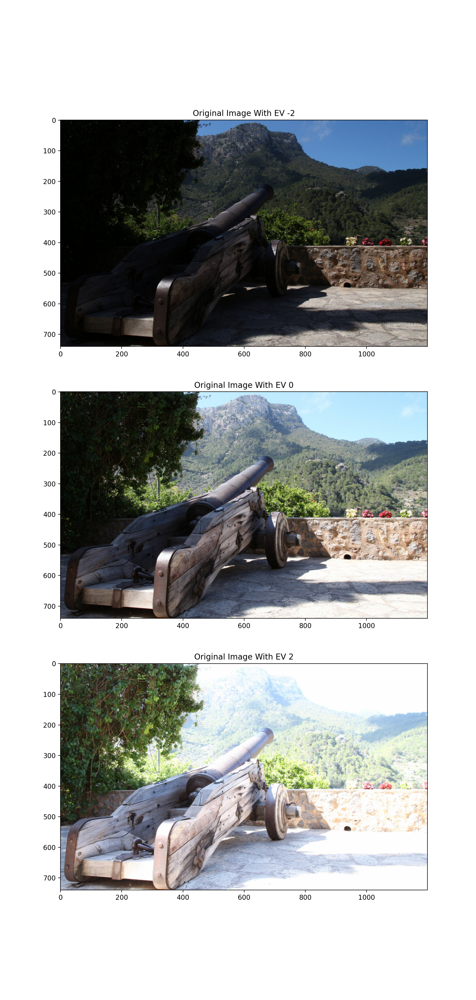

In [10]:
filename = "images/cannon"
images = load_imgs(filename)
num_images = 3
exps = np.array([-2, 0, 2])
plt.figure(figsize=(10,21))
for i in range(num_images):
    ax = plt.subplot(num_images,1,i+1)
    ax.imshow(images[i])
    ax.set_title('Original Image With EV '+str(exps[i]))


In [11]:
radiance = HDR(images)

<IPython.core.display.Javascript object>


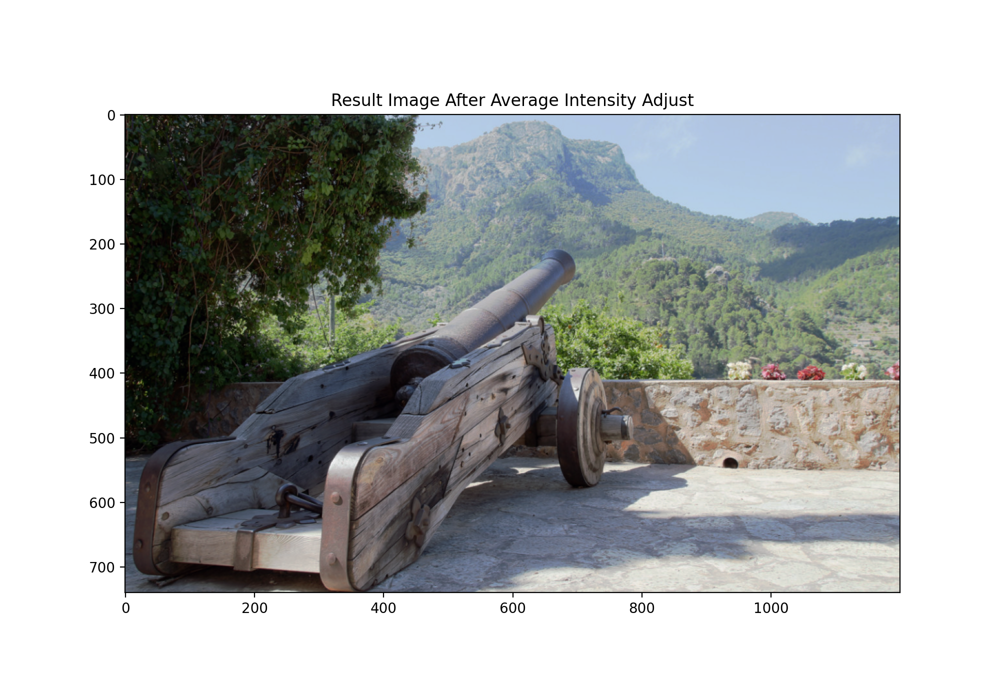

In [12]:
final_result = adjust(radiance, images)


Extend think one: images not taken with tripod  
We could use ransac method in class material(A2) to alignment input images.  

In [13]:
from skimage.feature import (corner_harris, corner_peaks, plot_matches, BRIEF, match_descriptors)
from skimage.transform import warp, ProjectiveTransform, EssentialMatrixTransform, FundamentalMatrixTransform
from skimage.color import rgb2gray
from skimage.measure import ransac

def alignment(imageL, imageR):
    imLgray = rgb2gray(imageL)
    imRgray = rgb2gray(imageR)

    keypointsL = corner_peaks(corner_harris(imLgray), threshold_rel=0.001, min_distance=15)
    keypointsR = corner_peaks(corner_harris(imRgray), threshold_rel=0.001, min_distance=15)
    
    extractor = BRIEF()

    extractor.extract(imLgray, keypointsL)
    keypointsL = keypointsL[extractor.mask]         
    descriptorsL = extractor.descriptors

    extractor.extract(imRgray, keypointsR)
    keypointsR = keypointsR[extractor.mask]
    descriptorsR = extractor.descriptors

    matchesLR = match_descriptors(descriptorsL, descriptorsR, cross_check=True)

    ptsL1 = []
    ptsR1 = []
    for i in matchesLR:
        ptsL1.append(keypointsL[i[0]])
        ptsR1.append(keypointsR[i[1]])
    ptsL1 = np.array(ptsL1)
    ptsR1 = np.array(ptsR1)

    ptsL = ptsL1[:,[1, 0]]
    ptsR = ptsR1[:,[1, 0]]

    # robustly estimate fundamental matrix using RANSAC
    F_trans, F_inliers = ransac((ptsL, ptsR), FundamentalMatrixTransform, min_samples=8, residual_threshold=0.1, max_trials=1500)
    print ('the number of inliers is {:2d}'.format(np.sum(F_inliers)))

    ind = np.ogrid[:ptsL.shape[0]]
    FmatchesRansac = np.column_stack((ind[F_inliers],ind[F_inliers]))
    return F_trans


Extend think two: unknown exposure  
When calculating response function, we used given exposure in previous algorithm. If we do not know it, we should extend variables(put exposure in left hand side x of equations). And then solve equations in the same way. Once we get the solution of exps, we could also use it to build radiance map.

In [20]:
def response_function_unknown_exps(Z, l, w):
    n = maxi - mini +1
    A = np.zeros((Z.shape[0]*Z.shape[1]+n+3, Z.shape[0]+Z.shape[1]+n))
    b = np.zeros((A.shape[0],1))
    
    # extend equations by adding new column and row to A and b
    k = 0  
    for i in range(Z.shape[0]):
        for j in range(Z.shape[1]):
            wij = w[Z[i,j]]
            A[k,Z[i,j]] = wij
            A[k,n+i] = -wij
            A[k,n+Z.shape[0]+j] = -wij
            k += 1   
    A[k,n//2] = 1
    k+=1
    A[k, n+Z.shape[0]+Z.shape[1]//2] = 10
    k+=1
    A[k, n+Z.shape[0]] = 10
    b[k,0] = -10
    k+=1 
        
    # now we could calculate both response function and exps
    x = np.linalg.lstsq(A,b)[0]
    g  = x[0:n  ,0]
    lt = x[n+Z.shape[0]: ,0]
    return g, lt

def HDR_unknown_exps(images):
    ch = images.shape[3]
    channels = range(ch)
    w = weight()
    result_img = np.zeros(images[0].shape)
    for i in channels:
        channel_imgs = images[:,:,:,i]
        # step1: sample intensity
        samples = sample_intensities(channel_imgs)
        # step2: response function
        response_func, calculated_exps = response_function_unknown_exps(samples, 100.0, w)
        # step3: radiance map
        img_radiance_map = radiance_map(channel_imgs, calculated_exps, response_func)
        result_img[:,:,i] = img_radiance_map
    return result_img

In [21]:
radiance2 = HDR_unknown_exps(images)

<ipython-input-20-4c1144fe2234>:24: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.
  x = np.linalg.lstsq(A,b)[0]
<ipython-input-6-608a4413dca9>:7: RuntimeWarning: overflow encountered in exp
  w = (np.exp(response_curve[index_value])) / (np.gradient(response_curve)[index_value])
<ipython-input-6-608a4413dca9>:8: RuntimeWarning: invalid value encountered in double_scalars
  img_radiance_map[i, j] = np.sum(w * (g-exps))/np.sum(w)


<IPython.core.display.Javascript object>


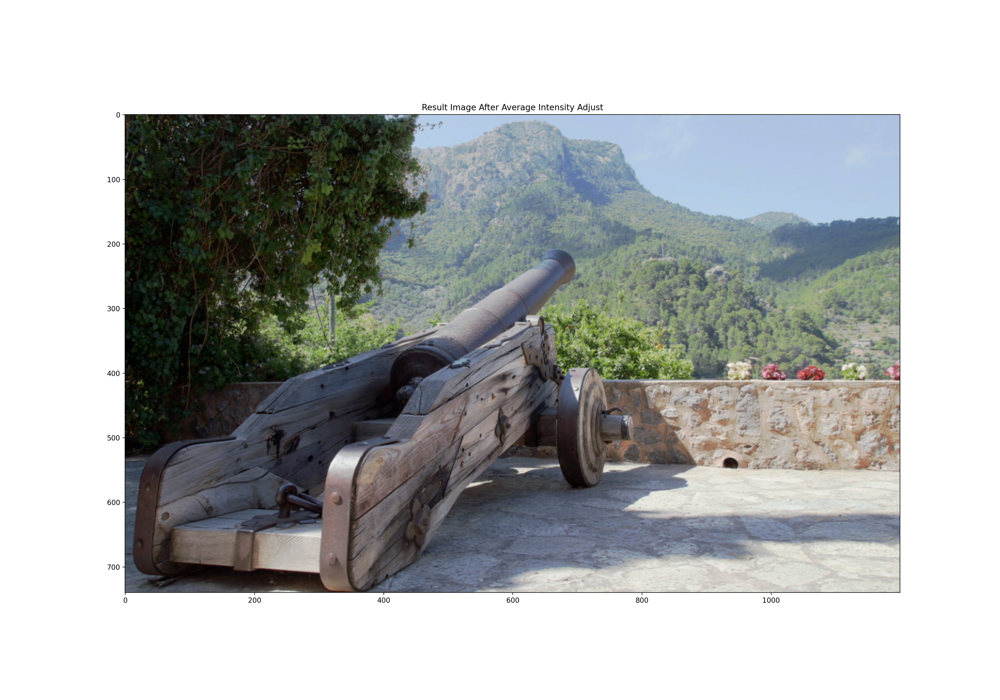

In [22]:
final_result2 = adjust(radiance, images)